# PCA and Neural Network Autoencoder Connection

We can learn principal component analysis (PCA) linear mapping from D-dimensions of data to M-dimensions of subspace where M < D by using a two-layer autoencoder neural network with linear activation. The model will learn to map from D-space to M-space by minimizing the mean squared error of the reconstruction and the true value.

The intuition why this is the case is because PCA is also a linear mapping that minimizes the mean squared error of the reconstruction of the datapoints from M-space to D-space.

In other words, PCA and a 2-layer neural network autoencoder are practically equivalent.

In [1]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchvision import datasets, transforms
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

from PIL import Image
from matplotlib import animation
from IPython.display import HTML

import warnings
warnings.filterwarnings("ignore")

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

device = 'cpu'
print(f"Using {device} device")

/Users/princejavier/anaconda3/envs/book/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/princejavier/anaconda3/envs/book/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <5AA8DD3D-A2CC-31CA-8060-88B4E9C18B09> /Users/princejavier/anaconda3/envs/book/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <E459C462-F863-3A5A-AC9F-FD77B14BE845> /Users/princejavier/anaconda3/envs/book/lib/python3.10/site-packages/torch/lib/libtorch_cpu.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


Using cpu device


We load the Wine dataset from Sklearn which has 13 columns that are all float64 and 178 datapoints (rows)

In [2]:
from sklearn import datasets
wine_data = datasets.load_wine(as_frame=True)
df = wine_data.data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   alcohol                       178 non-null    float64
 1   malic_acid                    178 non-null    float64
 2   ash                           178 non-null    float64
 3   alcalinity_of_ash             178 non-null    float64
 4   magnesium                     178 non-null    float64
 5   total_phenols                 178 non-null    float64
 6   flavanoids                    178 non-null    float64
 7   nonflavanoid_phenols          178 non-null    float64
 8   proanthocyanins               178 non-null    float64
 9   color_intensity               178 non-null    float64
 10  hue                           178 non-null    float64
 11  od280/od315_of_diluted_wines  178 non-null    float64
 12  proline                       178 non-null    float64
dtypes: fl

We show below a sample of the dataset

In [3]:
df.head()

,alcohol,malic_acid,ash,alcalinity_of_ash,magnesium,total_phenols,flavanoids,nonflavanoid_phenols,proanthocyanins,color_intensity,hue,od280/od315_of_diluted_wines,proline
0,14.23,1.71,2.43,15.6,127.0,2.80,3.06,0.28,2.29,5.64,1.04,3.92,1065.0
1,13.20,1.78,2.14,11.2,100.0,2.65,2.76,0.26,1.28,4.38,1.05,3.40,1050.0
2,13.16,2.36,2.67,18.6,101.0,2.80,3.24,0.30,2.81,5.68,1.03,3.17,1185.0
3,14.37,1.95,2.50,16.8,113.0,3.85,3.49,0.24,2.18,7.80,0.86,3.45,1480.0
4,13.24,2.59,2.87,21.0,118.0,2.80,2.69,0.39,1.82,4.32,1.04,2.93,735.0


In [4]:
# sns.pairplot(df)

We then train a neural network autoencoder with linear activation functions that maps 13 input variables to 2 hidden nodes then back to 13 output nodes. The goal is to learn a 2D-mapping from 13D dataset such that we can linearly reconstruct from 2D to 13D with minimal mean squared error. We visualize the network architecture below. 

Note that prior to training, we first standard scale the dataset so the values of the variables are comparable.

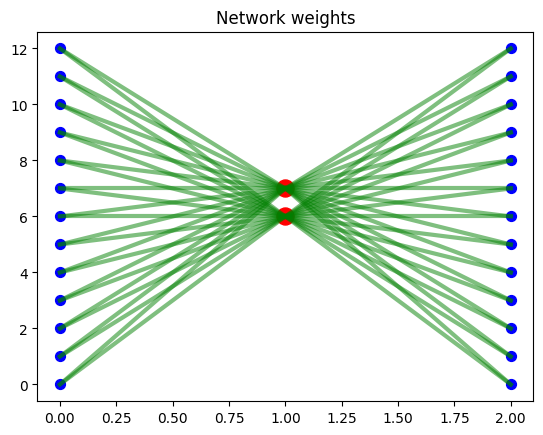

In [23]:
plt.scatter([0] * 13, np.arange(0, 13), c='b', s=150)
plt.scatter([1] * 2, np.arange(6, 8), c='r', s=150)
plt.scatter([2] * 13, np.arange(0, 13), c='b', s=150)    

for i in range(13):
    # to 1st node
    weight = 0.5
    if weight > 0:
        c = 'g'
    else:
        c = 'r'
    alpha = np.abs(weight)
    alpha = np.min([alpha, 1])

    plt.plot([0, 1], [i, 6], c=c, alpha=alpha, linewidth=3)

    # to 2nd node
    weight = 0.5
    if weight > 0:
        c = 'g'
    else:
        c = 'r'
    alpha = np.abs(weight)
    alpha = np.min([alpha, 1])

    plt.plot([0, 1], [i, 7], c=c, alpha=alpha, linewidth=3)    

    # from 1st node
    weight = 0.5
    if weight > 0:
        c = 'g'
    else:
        c = 'r'
    alpha = np.abs(weight)
    alpha = np.min([alpha, 1])

    plt.plot([1, 2], [6, i], c=c, alpha=alpha, linewidth=3)

    # from 2nd node
    weight = 0.5
    if weight > 0:
        c = 'g'
    else:
        c = 'r'
    alpha = np.abs(weight)
    alpha = np.min([alpha, 1])

    plt.plot([1, 2], [7, i], c=c, alpha=alpha, linewidth=3)
    # plt.set_axis_off()    
    plt.title("Network weights")

In [5]:
class NeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        self.flatten = nn.Flatten()
        self.stack = nn.Sequential(
            nn.Linear(13, 2),
            # nn.ReLU(),
            # nn.BatchNorm1d(2),
        )
        self.out = nn.Linear(2, 13)

    def forward(self, x):
        x = self.flatten(x)
        x = self.stack(x)        
        x = self.out(x)
        return x

In [6]:
class Custom_Dataset(Dataset):
  'Characterizes a dataset for PyTorch'
  def __init__(self, X):
        self.X = X
        'Initialization'

  def __len__(self):
        'Denotes the total number of samples'
        return len(self.X)

  def __getitem__(self, index):
        'Generates one sample of data'

        # Load data and get label
        x = torch.from_numpy(self.X[index])
        x = x.to(torch.float32)
        y = x

        return x, y

In [7]:
def train_loop(dataloader, model, loss_fn, optimizer):
    # Set the model to training mode - important for batch normalization and dropout layers
    # Unnecessary in this situation but added for best practices
    model.train()
    for batch, (x, y) in enumerate(dataloader):

        # Compute prediction and loss
        pred = model(x)
        loss = loss_fn(pred, y)

        # Backpropagation
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        if batch % 100 == 0:
            loss, current = loss.item(), batch * batch_size + len(x)
            # print(f"loss: {loss:>7f} ")

In [8]:
model = NeuralNetwork().to(device)
print(model)

NeuralNetwork(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (stack): Sequential(
    (0): Linear(in_features=13, out_features=2, bias=True)
  )
  (out): Linear(in_features=2, out_features=13, bias=True)
)


In [9]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

X = df.values
X = sc.fit_transform(X)

batch_size = 32
learning_rate = 4e-3

custom_dataset = Custom_Dataset(X)
train_dataloader = DataLoader(custom_dataset, batch_size=batch_size)

In [10]:
# Initialize the loss function
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

In [11]:
def train_model(model, epochs):
    for t in range(epochs):
        # print(f"Epoch {t+1}\n-------------------------------")
        train_loop(train_dataloader, model, loss_fn, optimizer)
    return model

In [12]:
# predict
def visualize(model, axs):
    model.eval()
    X_ = torch.from_numpy(X).to(torch.float32) # train_dataloader.dataset.__getitem__(1)[0]
    Y = model(X_)
    Y_feats = model.stack(X_).detach().numpy()
    s = 5


    axs[0].scatter(Y_feats[:, 0], Y_feats[:, 1], s=s)
    axs[0].set_xlabel("Feature 1")
    axs[0].set_ylabel("Feature 2")
    axs[0].set_title("Mapping to 2D Space")
    axs[0].set_xlim(-4, 4)
    axs[0].set_ylim(-4, 4)   

    axs[1].scatter(Y.detach().numpy(), X, s=s)
    axs[1].set_xlabel("predicted")
    axs[1].set_ylabel("true")
    axs[1].set_title("Predicted vs True")
    axs[1].set_xlim(-4.5, 4.5)
    axs[1].set_ylim(-4.5, 4.5)


    axs[0].spines[['right', 'top']].set_visible(False)
    axs[1].spines[['right', 'top']].set_visible(False)

    # NETWORK

    axs[2].scatter([0] * 13, np.arange(0, 13), c='b', s=50)
    axs[2].scatter([1] * 2, np.arange(6, 8), c='r', s=50)
    axs[2].scatter([2] * 13, np.arange(0, 13), c='b', s=50)    

    weights1 = model.state_dict()['stack.0.weight'].detach().numpy().T
    weights2 = model.state_dict()['out.weight'].detach().numpy()

    # sns.heatmap(np.around(weights1, 2), annot=True, cmap='viridis')
    # plt.show()
    # sns.heatmap(np.around(weights2, 2), annot=True, cmap='viridis')

    for i in range(13):
        # to 1st node
        weight = weights1[:, 0][i]
        if weight > 0:
            c = 'g'
        else:
            c = 'r'
        alpha = np.abs(weight)
        alpha = np.min([alpha, 1])

        axs[2].plot([0, 1], [i, 6], c=c, alpha=alpha, linewidth=3)

        # to 2nd node
        weight = weights1[:, 1][i]
        if weight > 0:
            c = 'g'
        else:
            c = 'r'
        alpha = np.abs(weight)
        alpha = np.min([alpha, 1])

        axs[2].plot([0, 1], [i, 7], c=c, alpha=alpha, linewidth=3)    

        # from 1st node
        weight = weights2[:, 0][i]
        if weight > 0:
            c = 'g'
        else:
            c = 'r'
        alpha = np.abs(weight)
        alpha = np.min([alpha, 1])

        axs[2].plot([1, 2], [6, i], c=c, alpha=alpha, linewidth=3)

        # from 2nd node
        weight = weights2[:, 1][i]
        if weight > 0:
            c = 'g'
        else:
            c = 'r'
        alpha = np.abs(weight)
        alpha = np.min([alpha, 1])

        axs[2].plot([1, 2], [7, i], c=c, alpha=alpha, linewidth=3)
        axs[2].set_axis_off()    
        axs[2].set_title("Network weights")
 
    plt.suptitle(f"Iter {str(iter).zfill(3)}")
    plt.tight_layout()

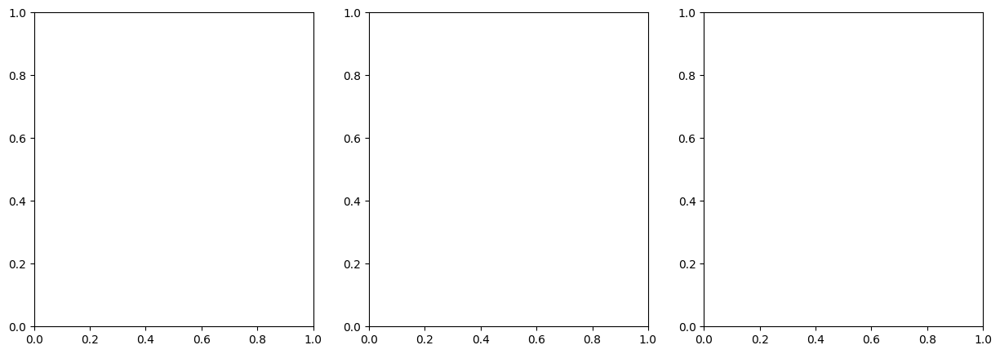

In [13]:
# animation
fig, axs = plt.subplots(1, 3, figsize=(15, 5)) # dpi=200)
axs = axs.flatten()

def animate(iter):
    global model 
    
    iter += 1
    epochs = 1
    model = train_model(model, epochs=epochs)    
    [ax.clear() for ax in axs]
    visualize(model, axs)    

    return None

We visualize below the 2D space mapping of the datapoints, predicted vs true values correlation plot of the different variables pooled together, and the network weights over 200 training iterations. We see that the model learns to "spread" the data point projection in 2D space (chart 1).

In [14]:
anim = animation.FuncAnimation(fig, 
                               animate, 
                               frames=200, 
                               interval=1)
HTML(anim.to_jshtml(fps=20))

<Figure size 640x480 with 0 Axes>

We show below the mapping in 2D space using standard PCA. We see that this projection matches with the projection using the autoencoder above (1st chart above). Although we note that the orientation along the axes are not the same. In other words, the two learned features do not necessarily correspond to the principal axes of PCA, however the learned 2D subspace still matches with the PCA subspace.

Again this is unsurprising because PCA and the linear autoencoder both learn linear mappings that minimize the mean squared error of the projection. They just solve this problem in different ways.

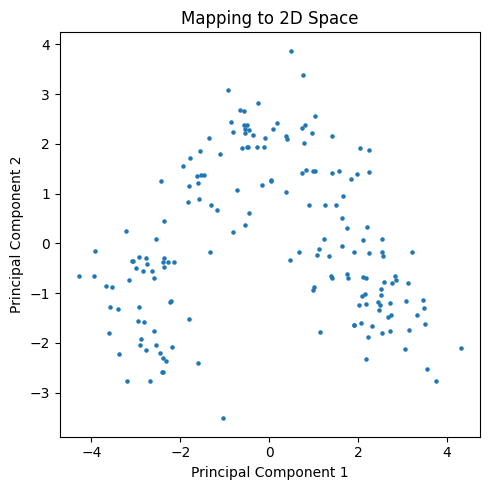

In [15]:
# PCA
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

s = 5
plt.figure(figsize=(5, 5))
plt.scatter(X_pca[:, 0], X_pca[:, 1], s=s)
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.title("Mapping to 2D Space")
plt.tight_layout()

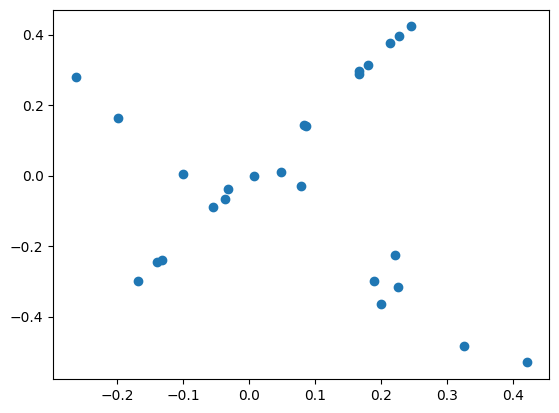

In [16]:
model_weights = model.state_dict()['stack.0.weight'].detach().numpy()
plt.scatter(model_weights[::-1], pca.components_)